# Reduce images of CTIO Data in January 2017
==================================================================================================

- author : Sylvie Dagoret-Campagne
- date   : January 24th 2017

### This notebook does reduction of images from Master Bias and Master Dark.
-----------------------------------------

- the images should have been previously Overscanned and Trimmed
- Notice the images are saved in images_notebooks/notebook_name
- must execute the javascript below first

In [3]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [4]:
print theNotebook

ReduceAllImages_HD60753


In [5]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits
import re
import os

In [6]:
import ccdproc
print 'ccdproc version',ccdproc.__version__

from astropy.modeling import models

ccdproc version 1.0.1


In [7]:
from scipy import stats  
from scipy import ndimage
from datetime import datetime, timedelta
from mpl_toolkits.mplot3d import Axes3D
import scipy.signal

In [8]:
import bottleneck as bn  # numpy's masked median is slow...really slow (in version 1.8.1 and lower)
print 'bottleneck version',bn.__version__

bottleneck version 1.0.0


In [9]:
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind
from photutils import CircularAperture
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
#from photutils.background import Background2D
from photutils import Background2D, SigmaClip, MedianBackground

In [10]:
from IPython.display import Image, display

In [11]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [12]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (8, 8),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [13]:
############################################################################
def ensure_dir(f):
    d = os.path.dirname(f)
    if not os.path.exists(f):
        os.makedirs(f)
#########################################################################

### Output directory for images generated in the notebook view (not true fits images)

In [14]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images

In [15]:
ensure_dir(dir_top_images) # create that directory

### Output of reduced fits images

In [16]:
outputdir="reduced_fitsimages"
ensure_dir(outputdir)

## Bias and Flat

In [17]:
inputbiasfile="MasterBias_CTIO_20170118.fits"

In [18]:
inputflatfile="MasterFlat_CTIO_20170118.fits"

In [19]:
master_bias = ccdproc.CCDData.read(inputbiasfile,unit=u.adu)

In [20]:
master_flat = ccdproc.CCDData.read(inputflatfile,unit=u.adu)

In [21]:
imstats = lambda dat: (dat.min(), dat.max(), dat.mean(), dat.std())

## Location of corrected images
----------------------------------

In [22]:
rootpath_rawimage="./trim_images"
object_name='HD60753'

In [23]:
#dirlist_all=os.listdir(rootpath_rawimage) 

In [24]:
#if '.DS_Store' in dirlist_all:
#    dirlist_all.remove('.DS_Store')
dirlist=[]
dirlist.append(rootpath_rawimage)
dirlist_all=np.array(dirlist)

In [25]:
print dirlist_all

['./trim_images']


In [26]:
indexes_files= [] # global list
filelist_fitsimages= []  # global list

In [27]:
def MakeFileList():
    """
    MakeFileList : Make The List of files to open
    =============
    """
    count=0
    
    for dir in dirlist_all: # loop on directories, one per image       
            dir_leaf= dir # build the name of leaf directory
            listfiles=os.listdir(dir_leaf) 
            for filename in listfiles:
                if re.search('^trim_20170117_([0-9]+).fits$',filename):  #example of filename filter
                    str_index=re.findall('^trim_20170117_([0-9]+).fits$',filename)
                    count=count+1
                    index=int(str_index[0])
                    indexes_files.append(index)         
                    shortfilename=dir_leaf+'/'+filename
                    filelist_fitsimages.append(shortfilename)
                    
    return

In [28]:
MakeFileList()   # Make the list

In [29]:
indexes_files=np.array(indexes_files)
filelist_fitsimages=np.array(filelist_fitsimages)

In [30]:
print len(indexes_files)

84


In [31]:
print len(filelist_fitsimages)

84


In [32]:
print indexes_files

[210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227
 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245
 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263
 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281
 282 283 284 285 286 287 288 289 290 291 292 293]


In [33]:
len(indexes_files)

84

In [34]:
filelist_fitsimages

array(['./trim_images/trim_20170117_210.fits',
       './trim_images/trim_20170117_211.fits',
       './trim_images/trim_20170117_212.fits',
       './trim_images/trim_20170117_213.fits',
       './trim_images/trim_20170117_214.fits',
       './trim_images/trim_20170117_215.fits',
       './trim_images/trim_20170117_216.fits',
       './trim_images/trim_20170117_217.fits',
       './trim_images/trim_20170117_218.fits',
       './trim_images/trim_20170117_219.fits',
       './trim_images/trim_20170117_220.fits',
       './trim_images/trim_20170117_221.fits',
       './trim_images/trim_20170117_222.fits',
       './trim_images/trim_20170117_223.fits',
       './trim_images/trim_20170117_224.fits',
       './trim_images/trim_20170117_225.fits',
       './trim_images/trim_20170117_226.fits',
       './trim_images/trim_20170117_227.fits',
       './trim_images/trim_20170117_228.fits',
       './trim_images/trim_20170117_229.fits',
       './trim_images/trim_20170117_230.fits',
       './tri

In [35]:
len(filelist_fitsimages)

84

In [36]:
#sorted_dates=np.argsort(filelist_fitsimages)

In [37]:
sorted_indexes=np.argsort(indexes_files) # sort the file indexes

In [38]:
sorted_indexes

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83])

In [39]:
#print sorted_dates

In [40]:
print sorted_indexes

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49
 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74
 75 76 77 78 79 80 81 82 83]


In [41]:
#sorted_files= [filelist_fitsimages[index] for index in sorted_indexes] # sort files
sorted_files=filelist_fitsimages[sorted_indexes]

In [42]:
#sorted_numbers= [indexes_files[index] for index in sorted_indexes]
sorted_numbers=indexes_files[sorted_indexes]

In [43]:
sorted_numbers

array([210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222,
       223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235,
       236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248,
       249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261,
       262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274,
       275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287,
       288, 289, 290, 291, 292, 293])

In [44]:
sorted_files

array(['./trim_images/trim_20170117_210.fits',
       './trim_images/trim_20170117_211.fits',
       './trim_images/trim_20170117_212.fits',
       './trim_images/trim_20170117_213.fits',
       './trim_images/trim_20170117_214.fits',
       './trim_images/trim_20170117_215.fits',
       './trim_images/trim_20170117_216.fits',
       './trim_images/trim_20170117_217.fits',
       './trim_images/trim_20170117_218.fits',
       './trim_images/trim_20170117_219.fits',
       './trim_images/trim_20170117_220.fits',
       './trim_images/trim_20170117_221.fits',
       './trim_images/trim_20170117_222.fits',
       './trim_images/trim_20170117_223.fits',
       './trim_images/trim_20170117_224.fits',
       './trim_images/trim_20170117_225.fits',
       './trim_images/trim_20170117_226.fits',
       './trim_images/trim_20170117_227.fits',
       './trim_images/trim_20170117_228.fits',
       './trim_images/trim_20170117_229.fits',
       './trim_images/trim_20170117_230.fits',
       './tri

## Build full filename
----------------------------

In [45]:
sorted_filenames=[]
for file in sorted_files:
    #fullfilename=os.path.join(rootpath_rawimage,file)
    fullfilename=file
    sorted_filenames.append(fullfilename)

In [46]:
sorted_filenames=np.array(sorted_filenames)

In [47]:
sorted_filenames

array(['./trim_images/trim_20170117_210.fits',
       './trim_images/trim_20170117_211.fits',
       './trim_images/trim_20170117_212.fits',
       './trim_images/trim_20170117_213.fits',
       './trim_images/trim_20170117_214.fits',
       './trim_images/trim_20170117_215.fits',
       './trim_images/trim_20170117_216.fits',
       './trim_images/trim_20170117_217.fits',
       './trim_images/trim_20170117_218.fits',
       './trim_images/trim_20170117_219.fits',
       './trim_images/trim_20170117_220.fits',
       './trim_images/trim_20170117_221.fits',
       './trim_images/trim_20170117_222.fits',
       './trim_images/trim_20170117_223.fits',
       './trim_images/trim_20170117_224.fits',
       './trim_images/trim_20170117_225.fits',
       './trim_images/trim_20170117_226.fits',
       './trim_images/trim_20170117_227.fits',
       './trim_images/trim_20170117_228.fits',
       './trim_images/trim_20170117_229.fits',
       './trim_images/trim_20170117_230.fits',
       './tri

## Acces to data of  images
----------------------------------

In [48]:
all_dates = []
all_airmass = []
all_images = []
all_titles = []
all_header = []
all_img = []

In [49]:
def BuildRawImages():
    """
    BuildRawImages
    ===============
    """

    global all_dates
    global all_airmass
    global all_images
    global all_titles
    global all_header
    global all_img 
    global sorted_filenames

    for idx,file in np.ndenumerate(sorted_filenames):   
        hdu_list=fits.open(file)
        header=hdu_list[0].header
        date_obs = header['DATE-OBS']
        airmass = header['AIRMASS']
        num=sorted_numbers[idx[0]]
        title=object_name+" z= {:3.2f} Nb={}".format(float(airmass),num)
        image_corr=hdu_list[0].data
        image=image_corr
        all_dates.append(date_obs)
        all_airmass.append(float(airmass))
        all_images.append(image)
        all_titles.append(title)
        all_header.append(header)
        hdu_list.close()

In [50]:
BuildRawImages()

## Show images
-----------------------

In [51]:
def ShowRawImages():
    """
    ShowRawImages: Show the raw images without background subtraction
    ==============
    """
    global all_images
    global all_titles
    global object_name

    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/5)+1

    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMAGES):
        ix=index%5
        iy=index/5
        im=axarr[iy,ix].imshow(all_images[index],vmin=-10,vmax=100)
        axarr[iy,ix].set_title(all_titles[index])
    title='Raw images of '.format(object_name)
    plt.suptitle(title,size=16)  
    figfilename=os.path.join(dir_top_images,'viewrawimages.pdf')
    plt.savefig(figfilename)                             

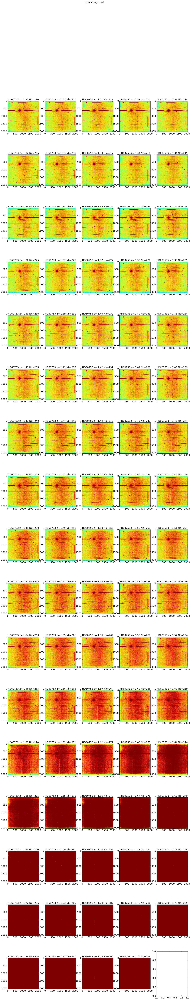

In [52]:
ShowRawImages()

In [53]:
#(y0,x0)=np.where(data2==data2.max())

## Show histograms
===========================

In [54]:
def ShowHistograms():
    """
    ShowHistograms
    ==============
    """
    global all_images
    global all_titles
    global object_name


    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/5)+1
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMAGES):
        ix=index%5
        iy=index/5
        image_flat=all_images[index].flatten()
        stat_mean=image_flat.mean()
        stat_rms=image_flat.std()
        legtitle='mean={:4.2f} std={:4.2f}'.format(stat_mean,stat_rms)
        axarr[iy,ix].hist(image_flat,bins=100,range=(-50,200),facecolor='blue', alpha=0.75,label=legtitle);
        axarr[iy,ix].set_yscale('log')
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_ylim(0.,1e10)
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].legend(loc='best')  #useless
    title='histo of images '.format(object_name)
    plt.suptitle(title,size=16)
    figfilename=os.path.join(dir_top_images,'histosrawimages.pdf')
    plt.savefig(figfilename)    

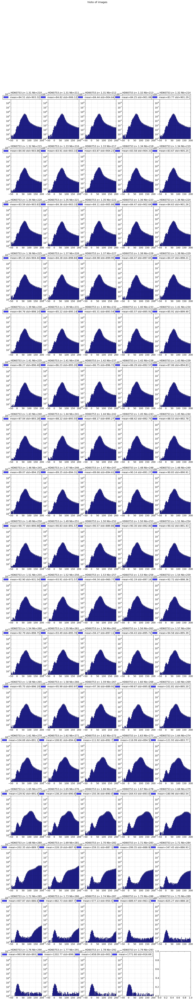

In [55]:
ShowHistograms()

## Transfer the image in CCDData
====================================

In [56]:
NBIMAGES=len(all_images)
all_rawimage = []
for index in np.arange(0,NBIMAGES):
    rawccd=ccdproc.CCDData(all_images[index],unit='adu')
    all_rawimage.append(rawccd)

## Does the reduction
===========================

### Step 1 : Subtract Bias to each raw image

In [57]:
all_bias_subtracted = []
for raw_image in all_rawimage:
    bias_subtracted = ccdproc.subtract_bias(raw_image, master_bias)
    all_bias_subtracted.append(bias_subtracted)

### Step 2 : Normalize by Flat

In [58]:
all_reduced = []
for bias_sub in all_bias_subtracted:
    reduced_image = ccdproc.flat_correct(bias_sub, master_flat,min_value=0.9)
    all_reduced.append(reduced_image)

## Plot Reduced Image
=========================

In [59]:
def PlotReduced():
    """
    PlotReduced
    ===============
    """
    
    global all_reduced
    global all_title
    global object_name
    
    NBBKG=len(all_reduced)
    MAXIMGROW=int(NBBKG/5)+1
      
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBBKG):
        ix=index%5
        iy=index/5
        im=axarr[iy,ix].imshow(all_reduced[index],vmin=0,vmax=60)
        axarr[iy,ix].set_title(all_titles[index])
    title='Reduced image {}'.format(object_name)

    #f.colorbar(im, ax=axarr.ravel().tolist(),shrink=0.75)
    f.colorbar(im)
    plt.suptitle(title,size=16) 
    figfilename=os.path.join(dir_top_images,'redimages.pdf')
    plt.savefig(figfilename)    

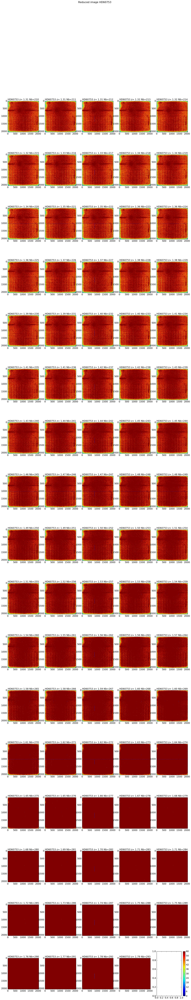

In [60]:
PlotReduced()

In [ ]:
def PlotHistoReduced():
    """
    """
    
    global all_reduced
    global all_title
    global object_name
    
    NBIMG=len(all_reduced)
    MAXIMGROW=int(NBIMG/5)+1
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMG):
        ix=index%5
        iy=index/5
        image_flat=all_reduced[index].data.flatten()
        stat_mean=image_flat.mean()
        stat_rms=image_flat.std()
        legtitle='mean={:4.2f} std={:4.2f}'.format(stat_mean,stat_rms)
        axarr[iy,ix].hist(image_flat,bins=120,range=(-50,200),facecolor='blue', alpha=0.75,label=legtitle);
        axarr[iy,ix].set_yscale('log')
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_ylim(0.,1e10)
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].legend(loc='best')  #useless
    title='histo of reduced images of {}'.format(object_name)
    plt.suptitle(title,size=16)
    figfilename=os.path.join(dir_top_images,'historedimages.pdf')
    plt.savefig(figfilename) 

In [ ]:
PlotHistoReduced()

## Save the files with background subtraction
----------------------------------------------------------

In [ ]:
sorted_newfiles=[]
for idx,file in np.ndenumerate(sorted_files):
    extracted=re.findall('./trim_images/trim_(.+)', file)
    rootfilename=extracted[0]
    newfilename='reduced_'+object_name+'_'+rootfilename
    newfullfilename=os.path.join(outputdir,newfilename)
    sorted_newfiles.append(newfullfilename)

In [ ]:
for idx,file in np.ndenumerate(sorted_newfiles):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=all_reduced[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(file,clobber=True)

In [ ]:
sorted_newfiles